In [1]:
import os
os.chdir('..')
import h5py
import cartopy.crs as ccrs
from notebooks import config
from utils.imgShow import imgShow
import matplotlib.pyplot as plt
from utils.geotif_io import readTiff
from utils.transform_xy import coor2coor


### **<font color=Yellow>Read</font>** <u>atl06</u> data by spots (groud tracks/beams) and orbits (ascending/descending)

In [2]:
# !h5ls data/icesat2/land_ice_antarctic/download_pineisland/processed_ATL06_20190102185636_00810212_004_01.h5 
# !python utils_main/read_atl06.py data/icesat2/land_ice_antarctic/download_pineisland/*ATL06*.h5 -o data/icesat2/land_ice_antarctic/preprocessed -n 4


### **<font color=Yellow>Merge</font>** the same spot with same orbit (ascending/descending) files into one files.

In [3]:
# ### ascending
# !python utils_main/merge_files.py data/icesat2/land_ice_antarctic/preprocessed/*ATL06*_spot1_A*.h5 -o data/icesat2/land_ice_antarctic/preprocessed/pineisland_atl06_spot1_A.h5
# !python utils_main/merge_files.py data/icesat2/land_ice_antarctic/preprocessed/*ATL06*_spot2_A*.h5 -o data/icesat2/land_ice_antarctic/preprocessed/pineisland_atl06_spot2_A.h5
# !python utils_main/merge_files.py data/icesat2/land_ice_antarctic/preprocessed/*ATL06*_spot3_A*.h5 -o data/icesat2/land_ice_antarctic/preprocessed/pineisland_atl06_spot3_A.h5
# !python utils_main/merge_files.py data/icesat2/land_ice_antarctic/preprocessed/*ATL06*_spot4_A*.h5 -o data/icesat2/land_ice_antarctic/preprocessed/pineisland_atl06_spot4_A.h5
# !python utils_main/merge_files.py data/icesat2/land_ice_antarctic/preprocessed/*ATL06*_spot5_A*.h5 -o data/icesat2/land_ice_antarctic/preprocessed/pineisland_atl06_spot5_A.h5
# !python utils_main/merge_files.py data/icesat2/land_ice_antarctic/preprocessed/*ATL06*_spot6_A*.h5 -o data/icesat2/land_ice_antarctic/preprocessed/pineisland_atl06_spot6_A.h5
# ### descending
# !python utils_main/merge_files.py data/icesat2/land_ice_antarctic/preprocessed/*ATL06*_spot1_D*.h5 -o data/icesat2/land_ice_antarctic/preprocessed/pineisland_atl06_spot1_D.h5
# !python utils_main/merge_files.py data/icesat2/land_ice_antarctic/preprocessed/*ATL06*_spot2_D*.h5 -o data/icesat2/land_ice_antarctic/preprocessed/pineisland_atl06_spot2_D.h5
# !python utils_main/merge_files.py data/icesat2/land_ice_antarctic/preprocessed/*ATL06*_spot3_D*.h5 -o data/icesat2/land_ice_antarctic/preprocessed/pineisland_atl06_spot3_D.h5
# !python utils_main/merge_files.py data/icesat2/land_ice_antarctic/preprocessed/*ATL06*_spot4_D*.h5 -o data/icesat2/land_ice_antarctic/preprocessed/pineisland_atl06_spot4_D.h5
# !python utils_main/merge_files.py data/icesat2/land_ice_antarctic/preprocessed/*ATL06*_spot5_D*.h5 -o data/icesat2/land_ice_antarctic/preprocessed/pineisland_atl06_spot5_D.h5
# !python utils_main/merge_files.py data/icesat2/land_ice_antarctic/preprocessed/*ATL06*_spot6_D*.h5 -o data/icesat2/land_ice_antarctic/preprocessed/pineisland_atl06_spot6_D.h5


### **<font color=Yellow>Merge</font>** the files of same oribit (ascending/descending) into one files.

In [4]:
### Ascending
# !python utils_main/merge_files.py data/icesat2/land_ice_antarctic/preprocessed/pineisland_atl06_spot?_A.h5 -o data/icesat2/land_ice_antarctic/preprocessed/pineisland_atl06_A.h5
### Descending
# !python utils_main/merge_files.py data/icesat2/land_ice_antarctic/preprocessed/pineisland_atl06_spot?_D.h5 -o data/icesat2/land_ice_antarctic/preprocessed/pineisland_atl06_D.h5



### **<font color=Yellow>Merge</font>** all the files (ascending/descending, spot1-spot6) into one files.

In [5]:
# !python utils_main/merge_files.py data/icesat2/land_ice_antarctic/preprocessed/*ATL06*_spot*.h5 -o data/icesat2/land_ice_antarctic/preprocessed/pineisland_atl06_AD.h5



### **<font color=Yellow>Split</font>** the files into tiles.


In [6]:
# !h5ls data/icesat2/land_ice_antarctic/preprocessed/pineisland_atl06_AD.h5
# !python utils_main/split_tiles.py data/icesat2/land_ice_antarctic/preprocessed/pineisland_atl06_AD.h5 -d 30 -c lon lat -p 3031 -n 1



### **<font color=Yellow> Split </font>** the file into multiple files.

In [7]:
# !h5ls data/icesat2/land_ice_antarctic/preprocessed/pineisland_atl06_spot1_A.h5 
# !python utils_main/split_file.py data/icesat2/land_ice_antarctic/preprocessed/pineisland_atl06_spot1_A.h5 -k 5


### **<font color=Yellow> Merge </font>** the tiles into one file by using merge_files.py.

In [8]:
# !h5ls data/icesat2/land_ice_antarctic/preprocessed/pineisland_atl06_tiles_merge.h5
# !python utils_main/merge_files.py data/icesat2/land_ice_antarctic/preprocessed/*_tile*.h5 \
#                 -o data/icesat2/land_ice_antarctic/preprocessed/pineisland_atl06_tiles_merge.h5


### **<font color=Yellow> Subset </font>** file by using specific region and time.

In [19]:
# !python utils_main/subset_file.py data/icesat2/land_ice_antarctic/preprocessed/pineisland_atl06_AD.h5  -r -101 -99 -75.3 -74.8 -t 2019.3 2019.8 -c lon lat -tn t_year



Input arguments:
('ifile', ['data/icesat2/land_ice_antarctic/preprocessed/pineisland_atl06_AD.h5'])
('region', [-101.0, -99.0, -75.3, -74.8])
('time', [2019.3, 2019.8])
('coord_name', ['lon', 'lat'])
('time_name', ['t_year'])
('input -> ', 'data/icesat2/land_ice_antarctic/preprocessed/pineisland_atl06_AD.h5')
t_year
('output ->', 'data/icesat2/land_ice_antarctic/preprocessed/pineisland_atl06_AD_subs.h5')


### **Visualization**

In [21]:
path_img = config.root + '/data/rs_img/pine_island_S3A_20180207T115228_20180207T115528.tif'
s3_img, s3_img_info = readTiff(path_img)
print(s3_img_info)


{'geoextent': (-1741002.5304, -1437153.6139, -380178.3167, -165679.325), 'geotrans': (-1741002.5304, 295.8606781888998, 0.0, -165679.325, 0.0, -295.8606782068966), 'geosrs': '3031', 'row': 725, 'col': 1027, 'bands': 3}


### 1. split into tiles and merged tiles.

In [3]:
## show splited tiles
with h5py.File('data/icesat2/land_ice_antarctic/preprocessed/pineisland_atl06_AD.h5','r') as f_a:
    lat_merge_ad   = f_a['lat'][:]
    lon_merge_ad   = f_a['lon'][:]
    h_elv_merge_ad = f_a['h_elv'][:]
    t_yrs_merge_ad = f_a['t_year'][:]

with h5py.File('data/icesat2/land_ice_antarctic/preprocessed/pineisland_atl06_AD_buff_0_epsg_3031_tile_004.h5','r') as f_a:
    lat_tile_ad   = f_a['lat'][:]
    lon_tile_ad   = f_a['lon'][:]
    h_elv_tile_ad = f_a['h_elv'][:]
    t_yrs_tile_ad = f_a['t_year'][:]

with h5py.File('data/icesat2/land_ice_antarctic/preprocessed/pineisland_atl06_tiles_merge.h5','r') as f_a:
    lat_tiles_merge   = f_a['lat'][:]
    lon_tiles_merge   = f_a['lon'][:]
    h_elv_tiles_merge = f_a['h_elv'][:]
    t_yrs_tiles_merge = f_a['t_year'][:]

x_ad, y_ad = coor2coor(srs_from=4326, srs_to=s3_img_info['geosrs'], x=lon_merge_ad, y=lat_merge_ad)
x_tile, y_tile = coor2coor(srs_from=4326, srs_to=s3_img_info['geosrs'], x=lon_tile_ad, y=lat_tile_ad)
x_tiles_merge, y_tiles_merge = coor2coor(srs_from=4326, srs_to=s3_img_info['geosrs'], x=lon_tiles_merge, y=lat_tiles_merge)


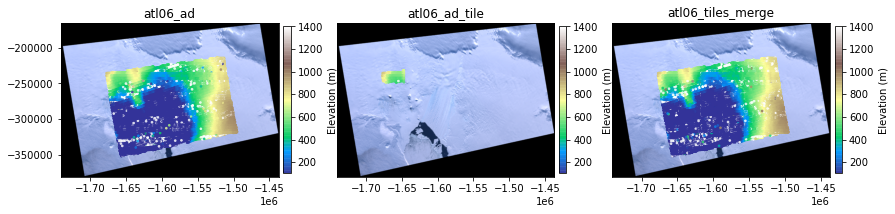

In [11]:
fig = plt.figure(figsize=(14,6))
plt.subplot(1,3,1)
imgShow(s3_img, extent=s3_img_info['geoextent'], color_bands=(0, 1, 2), clip_percent=5)
plt.scatter(x_ad[::100], y_ad[::100], s=3, c = h_elv_merge_ad[::100], alpha=.7, cmap='terrain')
plt.clim([100,1400])
plt.title('atl06_ad')
plt.colorbar(fraction=0.0320, pad=0.02, label='Elevation (m)')

plt.subplot(1,3,2)
imgShow(s3_img, extent=s3_img_info['geoextent'], color_bands=(0, 1, 2), clip_percent=5)
plt.scatter(x_tile[::100], y_tile[::100], s=3, c = h_elv_tile_ad[::100], alpha=.7, cmap='terrain')
plt.clim([100,1400])
plt.yticks([])
plt.title('atl06_ad_tile')
plt.colorbar(fraction=0.0320, pad=0.02, label='Elevation (m)')

plt.subplot(1,3,3)
imgShow(s3_img, extent=s3_img_info['geoextent'], color_bands=(0, 1, 2), clip_percent=5)
plt.scatter(x_tiles_merge[::100], y_tiles_merge[::100], s=3, c = h_elv_tiles_merge[::100], alpha=.7, cmap='terrain')
plt.clim([100,1400])
plt.yticks([])
plt.title('atl06_tiles_merge')
plt.colorbar(fraction=0.0320, pad=0.02, label='Elevation (m)')


### 2. file -> ascending -> spot 1

In [12]:
## splited spot1_ascending
with h5py.File('data/icesat2/land_ice_antarctic/preprocessed/processed_ATL06_20190102185636_00810212_004_01_gt1l_spot1_A.h5','r') as f_a:
    lat_spot1a_20190102   = f_a['lat'][:]
    lon_spot1a_20190102   = f_a['lon'][:]
    h_elv_spot1a_20190102 = f_a['h_elv'][:]
    t_yrs_spot1a_20190102 = f_a['t_year'][:]

## merged spot1_ascending
with h5py.File('data/icesat2/land_ice_antarctic/preprocessed/pineisland_atl06_spot1_A.h5','r') as f_a:
    lat_spot1a   = f_a['lat'][:]
    lon_spot1a   = f_a['lon'][:]
    h_elv_spot1a = f_a['h_elv'][:]
    t_yrs_spot1a = f_a['t_year'][:]

## merge all ascending/descending and spot1-spot6 
with h5py.File('data/icesat2/land_ice_antarctic/preprocessed/pineisland_atl06_AD.h5','r') as f_a:
    lat_merge_ad   = f_a['lat'][:]
    lon_merge_ad   = f_a['lon'][:]
    h_elv_merge_ad = f_a['h_elv'][:]
    t_yrs_merge_ad = f_a['t_year'][:]


## split spot1_ascending into 10 files
with h5py.File('data/icesat2/land_ice_antarctic/preprocessed/pineisland_atl06_spot1_A_000.h5','r') as f_a:
    lat_spot1a_000   = f_a['lat'][:]
    lon_spot1a_000   = f_a['lon'][:]
    h_elv_spot1a_000 = f_a['h_elv'][:]
    t_yrs_spot1a_000 = f_a['t_year'][:]

x_spot1a_20190102, y_spot1a_20190102 = coor2coor(srs_from=4326, srs_to=s3_img_info['geosrs'], x=lon_spot1a_20190102, y=lat_spot1a_20190102)
x_spot1a, y_spot1a = coor2coor(srs_from=4326, srs_to=s3_img_info['geosrs'], x=lon_spot1a, y=lat_spot1a)
x_ad, y_ad = coor2coor(srs_from=4326, srs_to=s3_img_info['geosrs'], x=lon_merge_ad, y=lat_merge_ad)
x_spot1a_000, y_spot1a_000 = coor2coor(srs_from=4326, srs_to=s3_img_info['geosrs'], x=lon_spot1a_000, y=lat_spot1a_000)



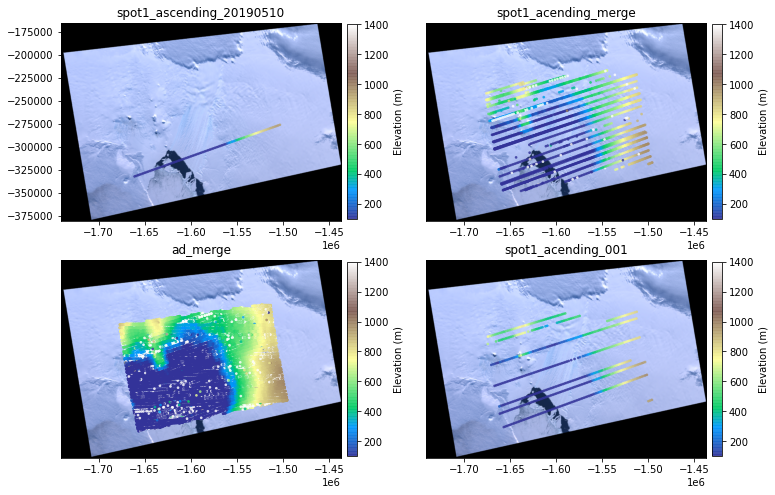

In [13]:
fig = plt.figure(figsize=(12,8))
plt.subplot(2,2,1)
imgShow(s3_img, extent=s3_img_info['geoextent'], color_bands=(0, 1, 2), clip_percent=5)
plt.scatter(x_spot1a_20190102[::100], y_spot1a_20190102[::100], s=3, c=h_elv_spot1a_20190102[::100], alpha=.7, cmap='terrain')
plt.clim([100,1400])
plt.title('spot1_ascending_20190510')
plt.colorbar(fraction=0.0320, pad=0.02, label='Elevation (m)')


plt.subplot(2,2,2)
imgShow(s3_img, extent=s3_img_info['geoextent'], color_bands=(0, 1, 2), clip_percent=5)
plt.scatter(x_spot1a[::100], y_spot1a[::100], s=3, c=h_elv_spot1a[::100], alpha=.7, cmap='terrain')
plt.clim([100,1400])
plt.yticks([])
plt.title('spot1_acending_merge')
plt.colorbar(fraction=0.0320, pad=0.02, label='Elevation (m)')


plt.subplot(2,2,3)
imgShow(s3_img, extent=s3_img_info['geoextent'], color_bands=(0, 1, 2), clip_percent=5)
plt.scatter(x_ad[::100], y_ad[::100], s=3, c=h_elv_merge_ad[::100], alpha=.7, cmap='terrain')
plt.clim([100,1400])
plt.yticks([])
plt.title('ad_merge')
plt.colorbar(fraction=0.0320, pad=0.02, label='Elevation (m)')

plt.subplot(2,2,4)
imgShow(s3_img, extent=s3_img_info['geoextent'], color_bands=(0, 1, 2), clip_percent=5)
plt.scatter(x_spot1a_000[::100], y_spot1a_000[::100], s=3, c=h_elv_spot1a_000[::100], alpha=.7, cmap='terrain')
plt.clim([100,1400])
plt.yticks([])
plt.title('spot1_acending_001')
plt.colorbar(fraction=0.0320, pad=0.02, label='Elevation (m)')


### 3. different spots (1-6) data

In [22]:
## spot1
with h5py.File('data/icesat2/land_ice_antarctic/preprocessed/pineisland_atl06_spot1_A.h5','r') as f_a:
    lat_spot1a   = f_a['lat'][:]
    lon_spot1a   = f_a['lon'][:]
    h_elv_spot1a = f_a['h_elv'][:]
    t_yrs_spot1a = f_a['t_year'][:]
    print(f_a.keys())

## spot2
with h5py.File('data/icesat2/land_ice_antarctic/preprocessed/pineisland_atl06_spot2_A.h5','r') as f_a:
    lat_spot2a   = f_a['lat'][:]
    lon_spot2a   = f_a['lon'][:]
    h_elv_spot2a = f_a['h_elv'][:]
    t_yrs_spot2a = f_a['t_year'][:]
## spot3
with h5py.File('data/icesat2/land_ice_antarctic/preprocessed/pineisland_atl06_spot3_A.h5','r') as f_a:
    lat_spot3a   = f_a['lat'][:]
    lon_spot3a   = f_a['lon'][:]
    h_elv_spot3a = f_a['h_elv'][:]
    t_yrs_spot3a = f_a['t_year'][:]
## spot4
with h5py.File('data/icesat2/land_ice_antarctic/preprocessed/pineisland_atl06_spot4_A.h5','r') as f_a:
    lat_spot4a   = f_a['lat'][:]
    lon_spot4a   = f_a['lon'][:]
    h_elv_spot4a = f_a['h_elv'][:]
    t_yrs_spot4a = f_a['t_year'][:]
## spot5
with h5py.File('data/icesat2/land_ice_antarctic/preprocessed/pineisland_atl06_spot5_A.h5','r') as f_a:
    lat_spot5a   = f_a['lat'][:]
    lon_spot5a   = f_a['lon'][:]
    h_elv_spot5a = f_a['h_elv'][:]
    t_yrs_spot5a = f_a['t_year'][:]
## spot6
with h5py.File('data/icesat2/land_ice_antarctic/preprocessed/pineisland_atl06_spot6_A.h5','r') as f_a:
    lat_spot6a   = f_a['lat'][:]
    lon_spot6a   = f_a['lon'][:]
    h_elv_spot6a = f_a['h_elv'][:]
    t_yrs_spot6a = f_a['t_year'][:]

x_spot1a, y_spot1a = coor2coor(srs_from=4326, srs_to=s3_img_info['geosrs'], x=lon_spot1a, y=lat_spot1a)
x_spot2a, y_spot2a = coor2coor(srs_from=4326, srs_to=s3_img_info['geosrs'], x=lon_spot2a, y=lat_spot2a)
x_spot3a, y_spot3a = coor2coor(srs_from=4326, srs_to=s3_img_info['geosrs'], x=lon_spot3a, y=lat_spot3a)
x_spot4a, y_spot4a = coor2coor(srs_from=4326, srs_to=s3_img_info['geosrs'], x=lon_spot4a, y=lat_spot4a)
x_spot5a, y_spot5a = coor2coor(srs_from=4326, srs_to=s3_img_info['geosrs'], x=lon_spot5a, y=lat_spot5a)
x_spot6a, y_spot6a = coor2coor(srs_from=4326, srs_to=s3_img_info['geosrs'], x=lon_spot6a, y=lat_spot6a)


<KeysViewHDF5 ['beam_type', 'cycle', 'h_elv', 'lat', 'lon', 'quality_summary', 'rgt', 'spot', 't_year']>


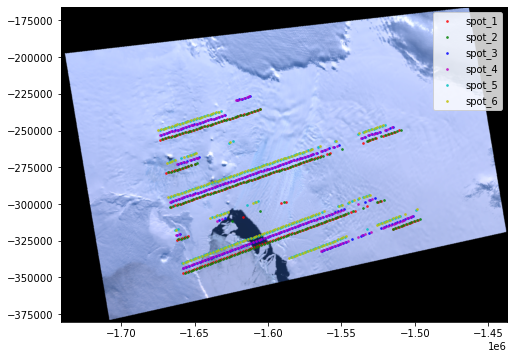

In [23]:
fig = plt.figure(figsize=(8, 8))
n_sam = 100
start_sam = 90000
end_sam = 110000
# start_sam = 0
# end_sam = x_spot1a.shape[0]
imgShow(s3_img, extent=s3_img_info['geoextent'], color_bands=(0, 1, 2), clip_percent=5)
plt.scatter(x_spot1a[start_sam:end_sam:n_sam],y_spot1a[start_sam:end_sam:n_sam],s=3,alpha=.7,c='r',label='spot_1')
plt.scatter(x_spot2a[start_sam:end_sam:n_sam],y_spot2a[start_sam:end_sam:n_sam],s=3,alpha=.7,c='g',label='spot_2')
plt.scatter(x_spot3a[start_sam:end_sam:n_sam],y_spot3a[start_sam:end_sam:n_sam],s=3,alpha=.7,c='b',label='spot_3')
plt.scatter(x_spot4a[start_sam:end_sam:n_sam],y_spot4a[start_sam:end_sam:n_sam],s=3,alpha=.7,c='m',label='spot_4')
plt.scatter(x_spot5a[start_sam:end_sam:n_sam],y_spot5a[start_sam:end_sam:n_sam],s=3,alpha=.7,c='c',label='spot_5')
plt.scatter(x_spot6a[start_sam:end_sam:n_sam],y_spot6a[start_sam:end_sam:n_sam],s=3,alpha=.7,c='y',label='spot_6')

# plt.xlim(-1.68*1e6, -1.65*1e6)
# plt.ylim(-255000, -240000)
plt.legend()



### 4. subset

In [25]:
## merge all ascending/descending and spot1-spot6 
with h5py.File('data/icesat2/land_ice_antarctic/preprocessed/pineisland_atl06_AD.h5','r') as f_a:
    lat_merge_ad   = f_a['lat'][:]
    lon_merge_ad   = f_a['lon'][:]
    h_elv_merge_ad = f_a['h_elv'][:]
    t_yrs_merge_ad = f_a['t_year'][:]


## merge all ascending/descending and spot1-spot6 
with h5py.File('data/icesat2/land_ice_antarctic/preprocessed/pineisland_atl06_AD_subs.h5','r') as f_a:
    lat_merge_subs   = f_a['lat'][:]
    lon_merge_subs   = f_a['lon'][:]
    h_elv_merge_subs = f_a['h_elv'][:]
    t_yrs_merge_subs = f_a['t_year'][:]


x_merge, y_merge = coor2coor(srs_from=4326, srs_to=s3_img_info['geosrs'], x=lon_merge_ad, y=lat_merge_ad)
x_merge_subs, y_merge_subs = coor2coor(srs_from=4326, srs_to=s3_img_info['geosrs'], x=lon_merge_subs, y=lat_merge_subs)

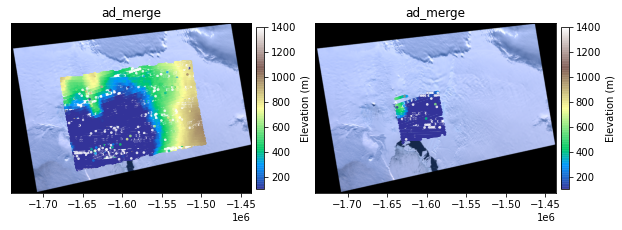

In [27]:
fig = plt.figure(figsize=(10,6))
plt.subplot(1,2,1)
imgShow(s3_img, extent=s3_img_info['geoextent'], color_bands=(0, 1, 2), clip_percent=5)
plt.scatter(x_ad[::100], y_ad[::100], s=3, c=h_elv_merge_ad[::100], alpha=.7, cmap='terrain')
plt.clim([100,1400])
plt.yticks([])
plt.title('ad_merge')
plt.colorbar(fraction=0.0320, pad=0.02, label='Elevation (m)')

plt.subplot(1,2,2)
imgShow(s3_img, extent=s3_img_info['geoextent'], color_bands=(0, 1, 2), clip_percent=5)
plt.scatter(x_merge_subs[::100], y_merge_subs[::100], s=3, c=h_elv_merge_subs[::100], alpha=.7, cmap='terrain')
plt.clim([100,1400])
plt.yticks([])
plt.title('ad_merge')
plt.colorbar(fraction=0.0320, pad=0.02, label='Elevation (m)')
